# Panfetal unconventional T cells
# 23 Mar 2022

In [1]:
import numpy as np
import scipy as sp
import scanpy as sc
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import rc
from matplotlib import colors
import seaborn as sb
from itertools import compress
import random
import joblib as jl
import matplotlib.patches as mpatches

sc.settings.set_figure_params(dpi = 160, color_map = 'RdYlBu_r', dpi_save = 300, format = 'pdf')
plt.rcParams["figure.figsize"] = [6,6]

In [2]:
import rpy2
%load_ext rpy2.ipython

In [3]:
sb.set_palette('tab10')

In [4]:
# import utils (in github folder src/utils/)
import sys
sys.path.append('/home/jovyan/Pan_fetal_immune/src/utils/')
from array_operations import *
from colors import *

In [5]:
organ_order = ['YS','LI','BM','TH','SP','MLN','SK','GU','KI']
#organ_name_order = ['Yolk Sac','Liver','Bone Marrow','Thymus','Spleen','Mesenteric Lymph Node','Skin','Gut','Kidney']
organ_color_map = dict(zip(organ_order, np.array(sb.color_palette('tab10'))[range(len(organ_order))]))

In [6]:
# set working directory
%cd /home/jovyan/panfetal/

/home/jovyan/panfetal


In [7]:
# figure directory
fig_path = '/home/jovyan/mount/gdrive/Pan_fetal/plots_output/chenqu_jhub/'
sc.settings.figdir = fig_path

# Load data

Processed datasets in h5ad format are available at https://developmentcellatlas.cellgeni.sanger.ac.uk/fetal-immune.

In [8]:
adata = sc.read('/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.NKT.embedding.h5ad')

Only considering the two last: ['.embedding', '.h5ad'].
Only considering the two last: ['.embedding', '.h5ad'].


In [9]:
adata.raw = adata.copy()

### exclude maternal contaminants

In [10]:
# in github folder metadata/souporcell_results/
maternal_barcodes = pd.read_csv('souporcell/maternal_barcodes.csv')

In [11]:
maternal_barcodes['barcodes'] = [barcode.split('-')[0]+'-'+barcode.split('-')[1] for barcode in maternal_barcodes['x']]

In [12]:
print(sum(adata.obs_names.isin(maternal_barcodes['barcodes'])))
adata = adata[~adata.obs_names.isin(maternal_barcodes['barcodes'])]

2086


### update annotation with anno_lvl_2_final_clean

In [13]:
obs = pd.read_csv('/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv', index_col = 0) # final annotations and removed maternal contaminant cells

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (6) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [14]:
for col in obs:
    adata.obs[col] = obs[col] # use anno_lvl_2_final_clean

Trying to set attribute `.obs` of view, copying.


In [15]:
adata.write_h5ad('write/NKT_final.h5ad')

... storing 'file' as categorical
... storing 'predicted_doublets' as categorical
... storing 'name' as categorical
... storing 'uniform_label' as categorical
... storing 'uniform_label_expanded_merged' as categorical
... storing 'uniform_label_lvl0' as categorical
... storing 'organ' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sort_id' as categorical
... storing 'method' as categorical
... storing 'donor' as categorical
... storing 'sex' as categorical
... storing 'Processing_method' as categorical
... storing 'AnnatomicalPart' as categorical
... storing 'Sample' as categorical
... storing 'anno_lvl_2_final_clean' as categorical


In [8]:
adata= sc.read('write/NKT_final.h5ad')

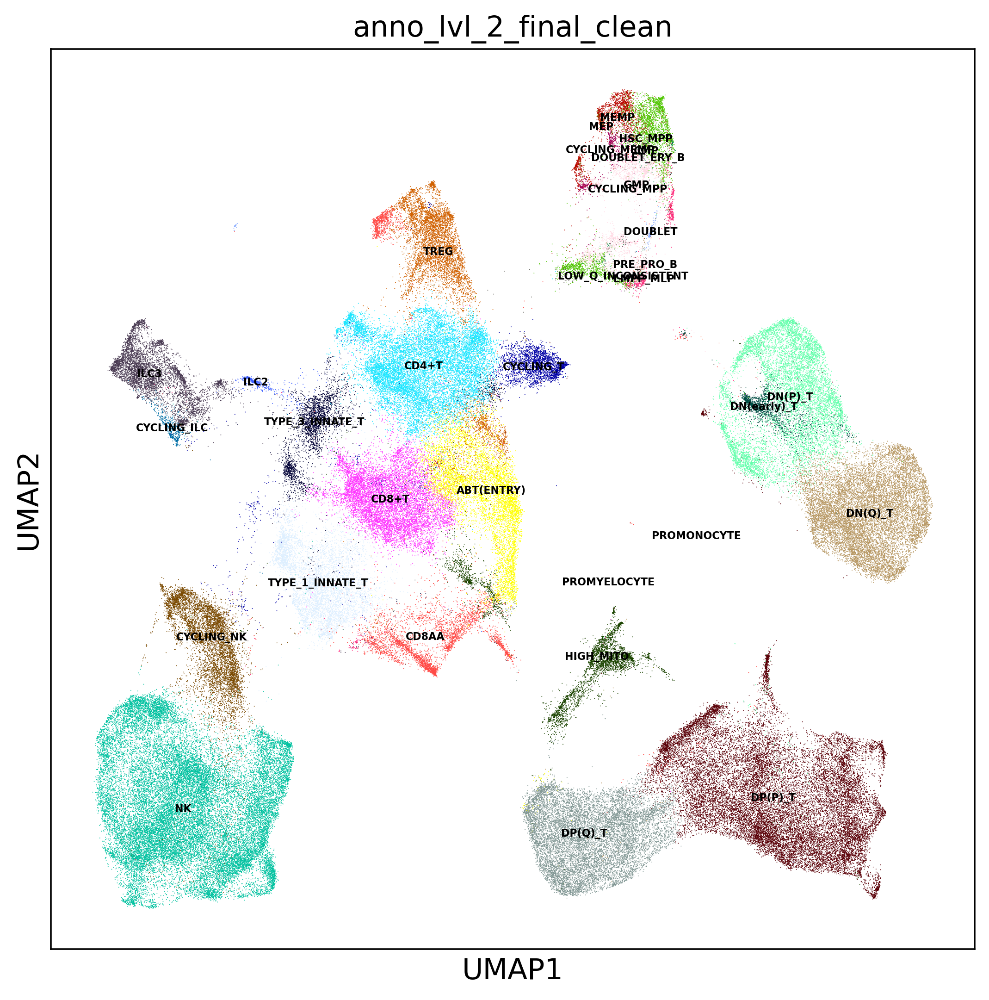

In [17]:
plt.rcParams["figure.figsize"] = [8,8]
sc.pl.umap(adata,color=['anno_lvl_2_final_clean'],legend_loc='on data',legend_fontsize=5)

# Load abTCR and gdTCR

results (merged TCR csvs) from TCR_load_clonal_expansion_paper_figure.ipynb

In [21]:
meta_gd = pd.read_csv('/home/jovyan/Pan_fetal_immune/metadata/gdTCR_metadata_23032022.csv')
gdtcr = pd.read_csv('csv/gdTCR_filtered_contig_merged_qc.csv',index_col=0)
gdtcr.columns=['gd_'+name for name in gdtcr.columns]

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (1,2,3,4,5,6,7,8,9,10,11,12,13,15,17,19,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [22]:
for col in gdtcr:
    adata.obs[col] = gdtcr[col]

In [23]:
meta_ab = pd.read_csv('/home/jovyan/Pan_fetal_immune/metadata/abTCR_metadata_23032022.csv')
abtcr = pd.read_csv('csv/abTCR_filtered_contig_merged_qc.csv',index_col=0)
abtcr.columns=['ab_'+name for name in abtcr.columns]

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (14,15,17,18,19,21) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [24]:
for col in abtcr:
    adata.obs[col] = abtcr[col]

In [25]:
a = list(adata.obs['gd_receptor_subtype']=='TRG+TRD')
b = list(adata.obs['gd_chain_pairing'].isin(['single pair','extra VJ','extra VDJ','two full chains']))
c = [a and b for a,b in zip(a,b)]
adata.obs.loc[c,'gdTCR'] = 'paired_gdTCR'
d = list(adata.obs['ab_receptor_subtype']=='TRA+TRB')
e = list(adata.obs['ab_chain_pairing'].isin(['single pair','extra VJ','extra VDJ','two full chains']))
f = [d and e for d,e in zip(d,e)]
adata.obs.loc[f,'abTCR'] = 'paired_abTCR'

In [26]:
df = [c and f for c,f in zip(c,f)]
sum(df) # six cells that have both paired gdTCR and abTCR

6

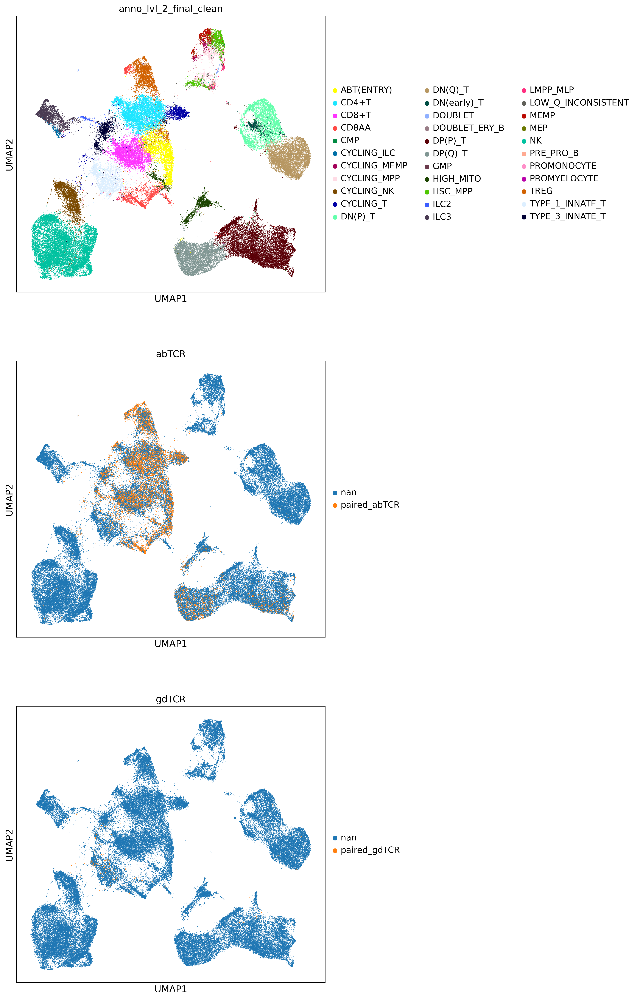

In [28]:
sc.pl.umap(adata,color=['anno_lvl_2_final_clean','abTCR','gdTCR'],ncols=1,size=2)

In [29]:
adata.write_h5ad('write/NKT_final_TCR.h5ad')

In [30]:
adata = sc.read('write/NKT_final_TCR.h5ad')

# Select mature T cells

In [31]:
a = adata.obs['anno_lvl_2_final_clean'].isin(['CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'])
b = ~(adata.obs['Sort_id'].isin(['CD137','MAIT']))
c = [a and b for a,b in zip(a,b)]
T = adata[c].copy()

In [32]:
T.obs['anno_lvl_2_final_clean'] = T.obs['anno_lvl_2_final_clean'].cat.reorder_categories(['CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'])

In [33]:
a = np.array(T.obsm['X_umap'][:,0]>-3) & np.array(T.obsm['X_umap'][:,0]<8) & np.array(T.obsm['X_umap'][:,1]>-2)
T_plot = T[a].copy()

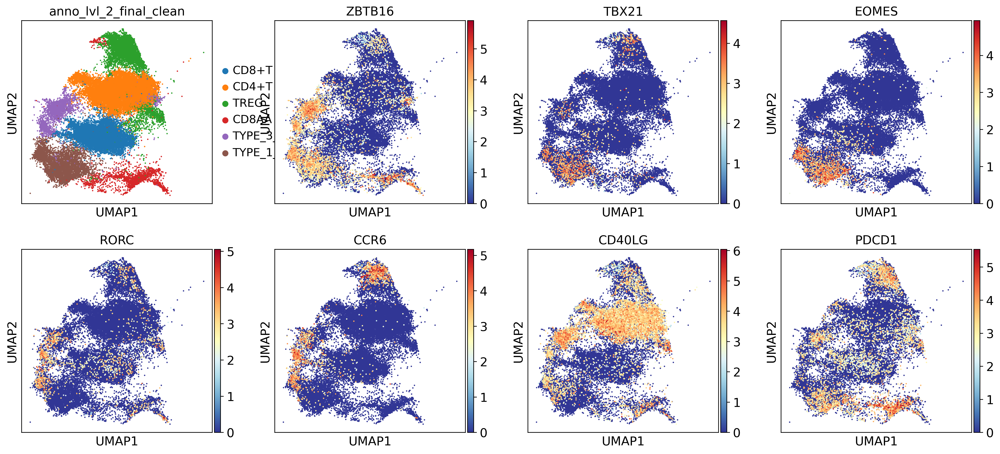

In [45]:
sc.pl.umap(T_plot, color=['anno_lvl_2_final_clean','ZBTB16','TBX21','EOMES','RORC','CCR6','CD40LG','PDCD1'], size = 10)

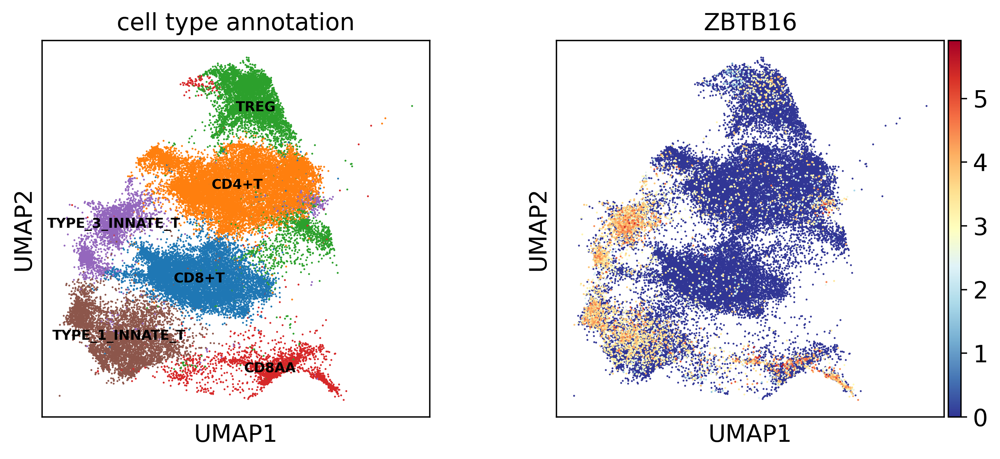

In [41]:
plt.rcParams["figure.figsize"] = [4,4]
sc.pl.umap(T_plot, color=['anno_lvl_2_final_clean','ZBTB16'],legend_loc='on data',legend_fontsize=8,size=5, title=['cell type annotation','ZBTB16'],
          palette = vega_20_scanpy,save='matureT_ZBTB16.pdf')

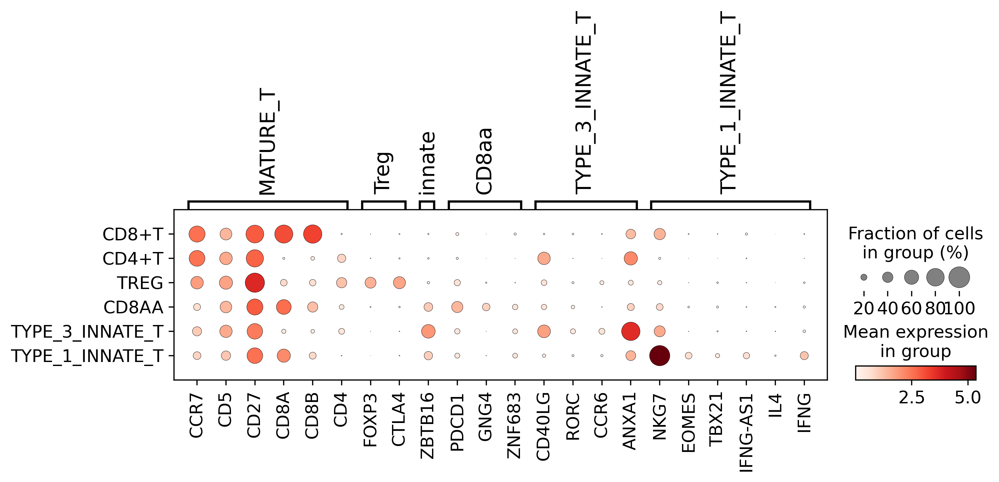

In [43]:
markers = {'MATURE_T':['CCR7','CD5','CD27','CD8A','CD8B','CD4'], 
           #'agonist selection':['TNFRSF9','CD27','IKZF2','IKZF3'],
           'Treg':['FOXP3','CTLA4'], 
           'innate':['ZBTB16'],
           'CD8aa':['PDCD1','GNG4','ZNF683'], 
           'TYPE_3_INNATE_T':['CD40LG','RORC','CCR6','ANXA1'],
           'TYPE_1_INNATE_T':['NKG7','EOMES','TBX21','IFNG-AS1','IL4','IFNG']
          }
sc.pl.dotplot(T, markers, 'anno_lvl_2_final_clean', dendrogram=False, use_raw=False, save='mature_T_anno.pdf')

# Plot unconventional / conventional T ratio across organ and age

In [46]:
adata_select = T.copy()
adata_select.obs['donor_organ']=np.char.array(adata_select.obs['donor'],unicode=True)+'_'+np.char.array(adata_select.obs['organ'],unicode=True)
adata_select.obs['donor_organ']=adata_select.obs['donor_organ'].astype('category')

In [47]:
cc1 = pd.DataFrame(index =list(adata_select.obs['donor_organ'].cat.categories), columns = list(adata_select.obs['anno_lvl_2_final_clean'].cat.categories)+['total'])

In [48]:
for donor_organ in cc1.index:
    counter = Counter(adata_select[adata_select.obs['donor_organ']==donor_organ].obs['anno_lvl_2_final_clean'])
    cc1.loc[donor_organ,'total']=sum(adata_select.obs['donor_organ']==donor_organ)
    for cell in cc1.columns[:-1]:
        cc1.loc[donor_organ,cell] = counter[cell]
    #cluster_counter.loc['B1%',sample]=counterB1[sample] / counterB[sample]
cc1 = cc1.astype('int64')

In [49]:
cc1['age'] = lookup(cc1.index, adata_select.obs, 'donor_organ', 'age')
cc1['organ'] = lookup(cc1.index, adata_select.obs, 'donor_organ', 'organ')

In [50]:
cc2 = cc1.loc[:,['TYPE_3_INNATE_T','TYPE_1_INNATE_T','CD8AA','total','age','organ']].copy()
#cc2.loc[:,['Th17','NKT','CD8αα']] = cc2.loc[:,['Th17','NKT','CD8αα']] / np.array(cc2['total']).reshape(23,1) * 100

In [51]:
bin_names = np.array(['7-9 pcw', '10-12 pcw', '13-15 pcw', '16-17 pcw']) # bin ages 
cc2['age_bin'] = bin_names[np.digitize(cc2['age'], [10, 13, 16])]
cc2['age_bin'] = cc2['age_bin'].astype('category').cat.reorder_categories(bin_names)
cc2['age_organ'] = cc2['age_bin'].astype('str') + '_' + cc2['organ'].astype('str')

In [52]:
tmp = cc2.groupby(['age_organ']).agg('sum')
cc3 = cc2.groupby(['age_organ']).first()
cc3.iloc[:,0:4] = tmp.iloc[:,0:4]

In [53]:
cc3['unconventional%']=(cc3['TYPE_3_INNATE_T']+cc3['TYPE_1_INNATE_T']+cc3['CD8AA'])/cc3['total'] * 100

In [54]:
cc3['organ']=cc3['organ'].astype('category')
cc3['organ']=cc3['organ'].cat.set_categories(organ_order).cat.remove_unused_categories()
organ_color_map = dict(zip(organ_order, np.array(sb.color_palette('tab10'))[range(len(organ_order))]))

In [28]:
cc3

,TYPE_3_INNATE_T,TYPE_1_INNATE_T,CD8AA,total,age,organ,age_bin,unconventional%
age_organ,,,,,,,,
10-12 pcw_BM,9,11,0,99,12.0,BM,10-12 pcw,20.202020
10-12 pcw_GU,1,3,1,8,12.0,GU,10-12 pcw,62.500000
10-12 pcw_KI,9,19,0,94,12.0,KI,10-12 pcw,29.787234
10-12 pcw_LI,50,125,18,353,11.0,LI,10-12 pcw,54.674221
10-12 pcw_SK,29,75,3,1439,10.0,SK,10-12 pcw,7.435719
10-12 pcw_SP,82,469,30,1038,11.0,SP,10-12 pcw,55.973025
10-12 pcw_TH,502,244,997,6421,11.0,TH,10-12 pcw,27.145304
13-15 pcw_BM,14,106,9,294,14.0,BM,13-15 pcw,43.877551
13-15 pcw_GU,179,137,38,887,15.0,GU,13-15 pcw,39.909808


/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


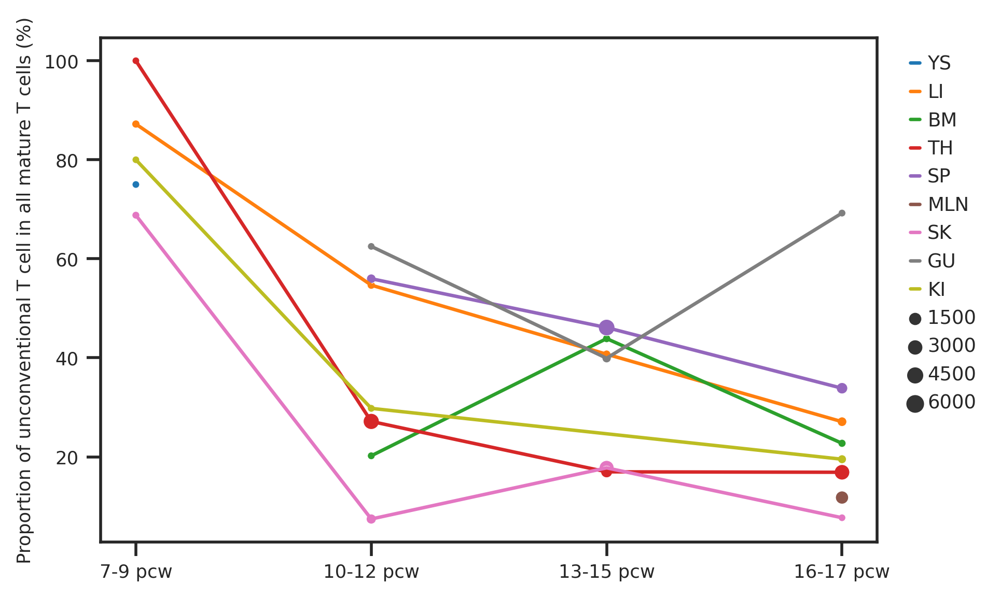

In [55]:
sb.set_theme(style='ticks')
fig, ax = plt.subplots(figsize=(6,4))
g = sb.lineplot(data=cc3, x='age_bin', y='unconventional%',hue='organ',palette=organ_color_map)
s = sb.scatterplot(cc3.loc[:,'age_bin'], cc3.loc[:,'unconventional%'],hue=cc3.loc[:,'organ'],
                    size =np.array(cc3.loc[:,'total'], dtype='float'),
                   sizes=(10, 50),palette=organ_color_map)
s.set_ylabel('Proportion of unconventional T cell in all mature T cells (%)', fontsize=8)
s.set(xlabel='')
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
ax.xaxis.grid(False)
h,l = ax.get_legend_handles_labels()
l1 = ax.legend(h[:9]+h[-4:],l[:9]+l[-4:], loc='upper left',bbox_to_anchor=(1.02, 1),frameon=False, fontsize='x-small')
plt.savefig(fig_path+'unconventionalT%_fetal_organ.pdf',bbox_inches='tight')

# Plot % unconventional T cell subtype within thymus dataset

data downloaded from https://zenodo.org/record/3711134#.YjyJFyzLeu5

In [30]:
jp_thymus = sc.read('/home/jovyan/thymusatlas/HTA08.v01.A05.Science_human_fig1.h5ad')

Only considering the two last: ['.Science_human_fig1', '.h5ad'].
Only considering the two last: ['.Science_human_fig1', '.h5ad'].


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [31]:
jp_thymus.var_names_make_unique()

In [32]:
jp_thymus.raw = jp_thymus.copy()

In [33]:
a = list(jp_thymus.obs['Anno_level_5'].isin(['TH17','NKT','Th17', 'CD8αα(I)', 'CD8αα(II)','CD4+T','CD8+T','Treg','Treg(diff)','T(agonist)','CD4+CTL', 'CD4+PD1','CD4+Tmem','CD8+Tmem','Tfh']))
adata_select = jp_thymus[a].copy()
adata_select.obs['anno_lvl_1_T']=adata_select.obs['Anno_level_5'].astype('str')
adata_select.obs.loc[adata_select.obs['Anno_level_5'].isin(['TH17','NKT','Th17', 'CD8αα(I)', 'CD8αα(II)']),'anno_lvl_1_T']='unconventional_T'
adata_select.obs.loc[adata_select.obs['Anno_level_5'].isin(['CD4+T','CD8+T','Treg','Treg(diff)','T(agonist)','CD4+CTL', 'CD4+PD1','CD4+Tmem','CD8+Tmem','Tfh']),'anno_lvl_1_T']='conventional_T'
adata_select.obs['anno_lvl_1_T']=adata_select.obs['anno_lvl_1_T'].astype('category')

In [34]:
cc1 = pd.DataFrame(index =list(adata_select.obs['donor'].cat.categories), columns = list(adata_select.obs['Anno_level_5'].cat.categories)+['total'])

In [35]:
for donor in cc1.index:
    counter = Counter(adata_select[adata_select.obs['donor']==donor].obs['Anno_level_5'])
    cc1.loc[donor,'total']=sum(adata_select.obs['donor']==donor)
    for cell in cc1.columns[:-1]:
        cc1.loc[donor,cell] = counter[cell]
    #cluster_counter.loc['B1%',sample]=counterB1[sample] / counterB[sample]
cc1 = cc1.astype('int64')

In [36]:
cc1['age'] = lookup(cc1.index, adata_select.obs, 'donor', 'Age')

In [37]:
cc2 = cc1.loc[:,['Th17','NKT','total','age']].copy()
cc2['CD8αα']=cc1['CD8αα(I)']+cc1['CD8αα(II)']
#cc2.loc[:,['Th17','NKT','CD8αα']] = cc2.loc[:,['Th17','NKT','CD8αα']] / np.array(cc2['total']).reshape(23,1) * 100

In [38]:
cc2['age_bin']=cc2['age']
# bin fetal ages
for donor in cc2.index:
    age = cc2.loc[donor,'age']
    if age in(['7w','8w','9w']):
        cc2.loc[donor,'age_bin'] = '7-9pcw'
    elif age in(['10w','11w','12w']):
        cc2.loc[donor,'age_bin'] = '10-12pcw'
    elif age in(['13w','14w','15w']):
        cc2.loc[donor,'age_bin'] = '13-15pcw'
    elif age in(['16w','17w']):
        cc2.loc[donor,'age_bin'] = '16-17pcw'
    elif age in(['3m','6m','10m']):
        cc2.loc[donor,'age_bin'] = '0-1y'
    elif age in(['15m','30m']):
        cc2.loc[donor,'age_bin'] = '1-5y'
    elif age in(['13y']):
        cc2.loc[donor,'age_bin'] = '5-15y'
    elif age in(['24y','35y']):
        cc2.loc[donor,'age_bin'] = '>15y'

In [39]:
cc3 = cc2.groupby(['age_bin']).agg('sum')

In [40]:
cc3.iloc[:,[0,1,3]] = cc3.iloc[:,[0,1,3]] / np.array(cc3['total']).reshape(cc3.shape[0],1) * 100
cc3['age_bin'] = cc3.index.astype('category')

In [41]:
cc2

,Th17,NKT,total,age,CD8αα,age_bin
A16,0,0,8171,24y,525,>15y
A43,2,4,2362,35y,53,>15y
C34,1,0,9,9w,6,7-9pcw
C40,39,20,82,7w,14,7-9pcw
C41,3,3,75,8w,67,7-9pcw
F21,25,20,1807,16w,97,16-17pcw
F22,0,10,60,9w,32,7-9pcw
F23,20,12,414,11w,60,10-12pcw
F29,114,31,4035,17w,275,16-17pcw
F30,43,49,3398,14w,270,13-15pcw


In [42]:
length = cc3.shape[0]
cc4 = pd.DataFrame({'age_bin':list(cc3['age_bin']) *3,
                   'total': list(cc3['total'])*3,
                    'ct':['TYPE_3_INNATE_T']*length+['TYPE_1_INNATE_T']*length+['CD8AA']*length,
                    'ct%':list(cc3['Th17'])+list(cc3['NKT'])+list(cc3['CD8αα'])})

In [43]:
cc4['age_bin'] = cc4['age_bin'].astype('category')
cc4['age_bin'] = cc4['age_bin'].cat.reorder_categories([ '7-9pcw','10-12pcw','13-15pcw','16-17pcw','0-1y','1-5y','5-15y','>15y'])

In [44]:
cc4

,age_bin,total,ct,ct%
0,0-1y,8256,TYPE_3_INNATE_T,0.472384
1,1-5y,10220,TYPE_3_INNATE_T,0.039139
2,10-12pcw,7334,TYPE_3_INNATE_T,4.049632
3,13-15pcw,5035,TYPE_3_INNATE_T,3.078451
4,16-17pcw,7405,TYPE_3_INNATE_T,2.525321
5,5-15y,1467,TYPE_3_INNATE_T,0.000000
6,7-9pcw,226,TYPE_3_INNATE_T,19.026549
7,>15y,10533,TYPE_3_INNATE_T,0.018988
8,0-1y,8256,TYPE_1_INNATE_T,0.629845
9,1-5y,10220,TYPE_1_INNATE_T,0.176125


/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


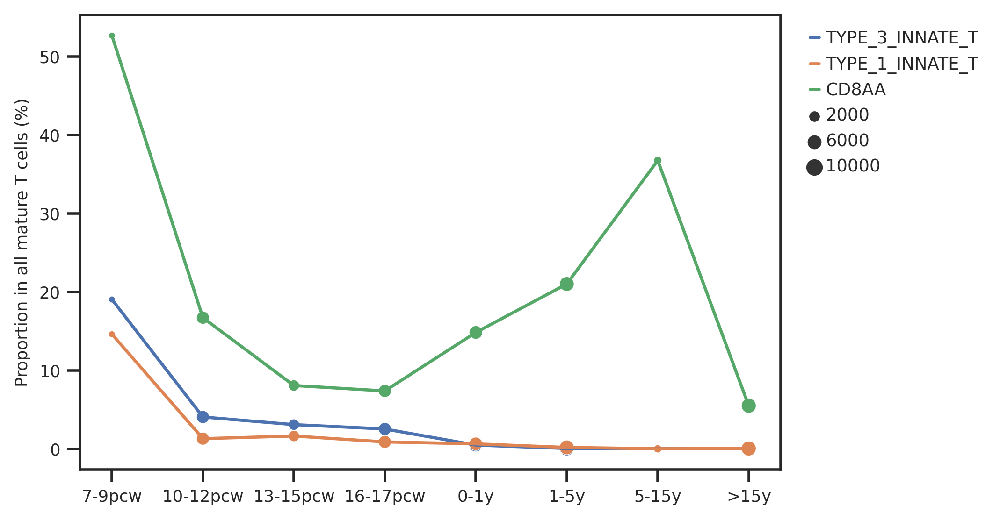

In [45]:
fig, ax = plt.subplots(figsize=(6,4))
g = sb.lineplot(data=cc4, x='age_bin', y='ct%',hue='ct')
s = sb.scatterplot(cc4.loc[:,'age_bin'], cc4.loc[:,'ct%'],hue=cc4.loc[:,'ct'],
                    size =np.array(cc4.loc[:,'total'], dtype='float'),
                   sizes=(10, 50))
s.set_ylabel('Proportion in all mature T cells (%)', fontsize=8)
s.set(xlabel='')
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
ax.xaxis.grid(False)
#s.legend(" ",bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='xx-small')
#s.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='xx-small')
h,l = ax.get_legend_handles_labels()
l1 = ax.legend(h[:3]+[h[-5]]+[h[-3]]+[h[-1]],l[:3]+[l[-5]]+[l[-3]]+[l[-1]], loc='upper left',bbox_to_anchor=(1.02, 1),frameon=False, fontsize='x-small')
plt.savefig(fig_path+'unconventionalT_jp_thymus.pdf',bbox_inches='tight')

# abTCR usage

In [61]:
# only take samples that had TCR sequencing done, and exclude CD137, MAIT sort
adata_abtcr = adata[adata.obs['file'].isin(meta_ab['GEX_id'])].copy()
adata_abtcr = adata_abtcr[~(adata_abtcr.obs['Sort_id'].isin(['CD137','MAIT']))]

In [62]:
# load TCR list by location - lists in github folder metadata/TCR_genes
TCR_list_by_loc = []
TCR_list_by_loc_dict = {}
for chain in ['TRAV','TRAJ','TRBV','TRBD','TRBJ']:
    path = '/home/jovyan/Pan_fetal_immune/metadata/TCR_genes/'+chain+'_list_by_location.csv'
    TCR_list_by_loc_dict[chain] = list(pd.read_csv(path, header=None)[0])
    TCR_list_by_loc = TCR_list_by_loc + TCR_list_by_loc_dict[chain]

In [63]:
# check all genes from adata are inside
TRAV_list = list(adata_abtcr.obs['ab_IR_VJ_1_v_gene'].cat.categories[:-1])
TRAJ_list = list(adata_abtcr.obs['ab_IR_VJ_1_j_gene'].cat.categories[:-1])
TRBV_list = list(adata_abtcr.obs['ab_IR_VDJ_1_v_gene'].cat.categories[:-1])
TRBD_list = list(adata_abtcr.obs['ab_IR_VDJ_1_d_gene'].cat.categories[:-1])
TRBJ_list = list(adata_abtcr.obs['ab_IR_VDJ_1_j_gene'].cat.categories[:-1])
TCR_list = TRAV_list+TRAJ_list+TRBV_list+TRBD_list+TRBJ_list

In [64]:
sum(~pd.Series(TCR_list).isin(TCR_list_by_loc))

0

### LR for TRAV, TRAJ - to find whether it is different btw conventional vs unconventional T, controlling for donor and organ

In [79]:
ct_select =['TYPE_3_INNATE_T','TYPE_1_INNATE_T','CD8AA','CD4+T','TREG','CD8+T'] 

TRAV

In [77]:
df = adata_abtcr.obs.loc[:,['anno_lvl_2_final_clean','ab_IR_VJ_1_v_gene','donor','Sample','organ']]

In [87]:
# only leave mature T cells, and cells with a TRAV gene
df = df.loc[df['anno_lvl_2_final_clean'].isin(ct_select) & ~(df['ab_IR_VJ_1_v_gene']=='nan'),:]

In [91]:
df.loc[df['anno_lvl_2_final_clean'].isin(['TYPE_3_INNATE_T','TYPE_1_INNATE_T','CD8AA']),'ct_cat'] = 'uncon'
df.loc[df['anno_lvl_2_final_clean'].isin(['CD4+T','TREG','CD8+T']),'ct_cat'] = 'con'

In [92]:
df

,anno_lvl_2_final_clean,ab_IR_VJ_1_v_gene,donor,Sample,organ,ct_cat
index,,,,,,
FCAImmP7579224-AATCGGTCATGCCTTC,CD4+T,TRAV2,F45,F45_SK_CD45P_FCAImmP7579224,SK,con
FCAImmP7579224-CGAGCACGTTGTCTTT,CD8+T,TRAV5,F45,F45_SK_CD45P_FCAImmP7579224,SK,con
FCAImmP7579224-GGCTCGAGTAGGAGTC,CD4+T,TRAV12-2,F45,F45_SK_CD45P_FCAImmP7579224,SK,con
FCAImmP7579224-GGTGTTAAGATCCCAT,CD8+T,TRAV25,F45,F45_SK_CD45P_FCAImmP7579224,SK,con
FCAImmP7579224-TTCTACAGTAGCACGA,CD4+T,TRAV13-1,F45,F45_SK_CD45P_FCAImmP7579224,SK,con
...,...,...,...,...,...,...
FCAImmP7579226-GGATTACCAAGTCTAC,TYPE_1_INNATE_T,TRAV21,F45,F45_LI_CD45P_FCAImmP7579226,LI,uncon
FCAImmP7579226-GGACGTCAGTGTACTC,TYPE_3_INNATE_T,TRAV13-1,F45,F45_LI_CD45P_FCAImmP7579226,LI,uncon
FCAImmP7579226-CCCATACCACGTCAGC,CD4+T,TRAV12-1,F45,F45_LI_CD45P_FCAImmP7579226,LI,con


In [116]:
%%R -i df
unique_genes <- unique(df$ab_IR_VJ_1_v_gene)
pval <- logOddsRatio <- setNames(rep(0, length(unique_genes)), unique_genes)
for (gene in unique_genes){
    is_gene <- df$ab_IR_VJ_1_v_gene == gene
    fit <- glm(is_gene ~ ct_cat + organ + donor, data=df, family='binomial')
    logOddsRatio[gene] <- summary(fit)$coefficients['ct_catuncon', 'Estimate']
    pval[gene] <- summary(fit)$coefficients['ct_catuncon', 4]
}
results = as.data.frame(cbind(logOddsRatio, pval))
results$adj_pval = p.adjust(results$pval, method = 'BH')
results[results$adj_pval<0.05,]
### only difference btw chisq and here is loss of TRAV12-3 and gain of TRAV12-1

           logOddsRatio         pval     adj_pval
TRAV2        -0.5098257 9.610687e-03 3.669533e-02
TRAV41        0.6536292 3.035407e-07 1.365933e-05
TRAV8-3      -0.3258940 8.910065e-03 3.669533e-02
TRAV22        0.4780030 3.071020e-03 1.535510e-02
TRAV23/DV6   -0.4392142 9.785420e-03 3.669533e-02
TRAV29/DV5    0.2961046 1.201513e-03 9.011344e-03
TRAV12-1     -0.2819867 1.415237e-02 4.898897e-02
TRAV35        0.5274678 5.920186e-04 8.880279e-03
TRAV38-1      0.4939336 8.456321e-04 9.011344e-03
TRAV26-2      0.7002078 1.759172e-03 1.130896e-02
TRAV10        0.5230788 1.063334e-03 9.011344e-03
TRAV3        -0.5943346 2.003085e-04 4.506941e-03
TRAV39        0.6836359 2.312675e-03 1.300880e-02


TRAJ

In [117]:
df = adata_abtcr.obs.loc[:,['anno_lvl_2_final_clean','ab_IR_VJ_1_j_gene','donor','Sample','organ']]

In [118]:
# only leave mature T cells, and cells with a TRAV gene
df = df.loc[df['anno_lvl_2_final_clean'].isin(ct_select) & ~(df['ab_IR_VJ_1_j_gene']=='nan'),:]

In [119]:
df.loc[df['anno_lvl_2_final_clean'].isin(['TYPE_3_INNATE_T','TYPE_1_INNATE_T','CD8AA']),'ct_cat'] = 'uncon'
df.loc[df['anno_lvl_2_final_clean'].isin(['CD4+T','TREG','CD8+T']),'ct_cat'] = 'con'

In [120]:
df

,anno_lvl_2_final_clean,ab_IR_VJ_1_j_gene,donor,Sample,organ,ct_cat
index,,,,,,
FCAImmP7579224-AATCGGTCATGCCTTC,CD4+T,TRAJ31,F45,F45_SK_CD45P_FCAImmP7579224,SK,con
FCAImmP7579224-CGAGCACGTTGTCTTT,CD8+T,TRAJ15,F45,F45_SK_CD45P_FCAImmP7579224,SK,con
FCAImmP7579224-GGCTCGAGTAGGAGTC,CD4+T,TRAJ50,F45,F45_SK_CD45P_FCAImmP7579224,SK,con
FCAImmP7579224-GGTGTTAAGATCCCAT,CD8+T,TRAJ47,F45,F45_SK_CD45P_FCAImmP7579224,SK,con
FCAImmP7579224-TTCTACAGTAGCACGA,CD4+T,TRAJ48,F45,F45_SK_CD45P_FCAImmP7579224,SK,con
...,...,...,...,...,...,...
FCAImmP7579226-GGATTACCAAGTCTAC,TYPE_1_INNATE_T,TRAJ33,F45,F45_LI_CD45P_FCAImmP7579226,LI,uncon
FCAImmP7579226-GGACGTCAGTGTACTC,TYPE_3_INNATE_T,TRAJ40,F45,F45_LI_CD45P_FCAImmP7579226,LI,uncon
FCAImmP7579226-CCCATACCACGTCAGC,CD4+T,TRAJ41,F45,F45_LI_CD45P_FCAImmP7579226,LI,con


In [123]:
%%R -i df
unique_genes <- unique(df$ab_IR_VJ_1_j_gene)
pval <- logOddsRatio <- setNames(rep(0, length(unique_genes)), unique_genes)
for (gene in unique_genes){
    is_gene <- df$ab_IR_VJ_1_j_gene == gene
    fit <- glm(is_gene ~ ct_cat + organ + donor, data=df, family='binomial')
    logOddsRatio[gene] <- summary(fit)$coefficients['ct_catuncon', 'Estimate']
    pval[gene] <- summary(fit)$coefficients['ct_catuncon', 4]
}
results = as.data.frame(cbind(logOddsRatio, pval))
results$adj_pval = p.adjust(results$pval, method = 'BH')
results[results$adj_pval<0.05,]
### only difference btw chisq and here is gain of TRAJ38

       logOddsRatio         pval     adj_pval
TRAJ48    0.3745527 3.456878e-04 0.0044939413
TRAJ49    0.3406926 5.978685e-04 0.0062178323
TRAJ53    0.4603485 1.472332e-04 0.0038280622
TRAJ38   -0.5910486 5.896999e-03 0.0383304921
TRAJ5    -0.7000150 2.667406e-03 0.0198150197
TRAJ57    0.6159617 2.303574e-04 0.0039928625
TRAJ10   -0.8214628 1.981781e-03 0.0171754384
TRAJ58    0.8479771 1.455589e-05 0.0007569064


### heatmap plotting

In [122]:
ct_select =['DN(P)_T','DN(Q)_T','DP(P)_T','DP(Q)_T','TYPE_1_INNATE_T','TYPE_3_INNATE_T','CD8AA','CD4+T','TREG','CD8+T'] # for beta chain
#ct_select =['DP(P)_T','DP(Q)_T','TYPE_1_INNATE_T','TYPE_3_INNATE_T','CD8AA','CD4+T','TREG','CD8+T'] # for alpha chain
TCR_chain = pd.DataFrame(columns = TCR_list_by_loc_dict['TRBJ'],  index = ct_select)

In [123]:
for i in range(TCR_chain.shape[0]):
    cell = TCR_chain.index[i]
    counter = Counter(adata_abtcr.obs.loc[adata_abtcr.obs['anno_lvl_2_final_clean']==cell,'ab_IR_VDJ_1_j_gene'])
    for chain_type in TCR_chain.columns:
        TCR_chain.loc[cell,chain_type] = counter[chain_type]
        
    TCR_chain.loc[cell,:] = TCR_chain.loc[cell,:] / np.sum(TCR_chain.loc[cell,:]) * 100

In [124]:
TCR_chain.columns = [a.replace('TR','') for a in TCR_chain.columns]

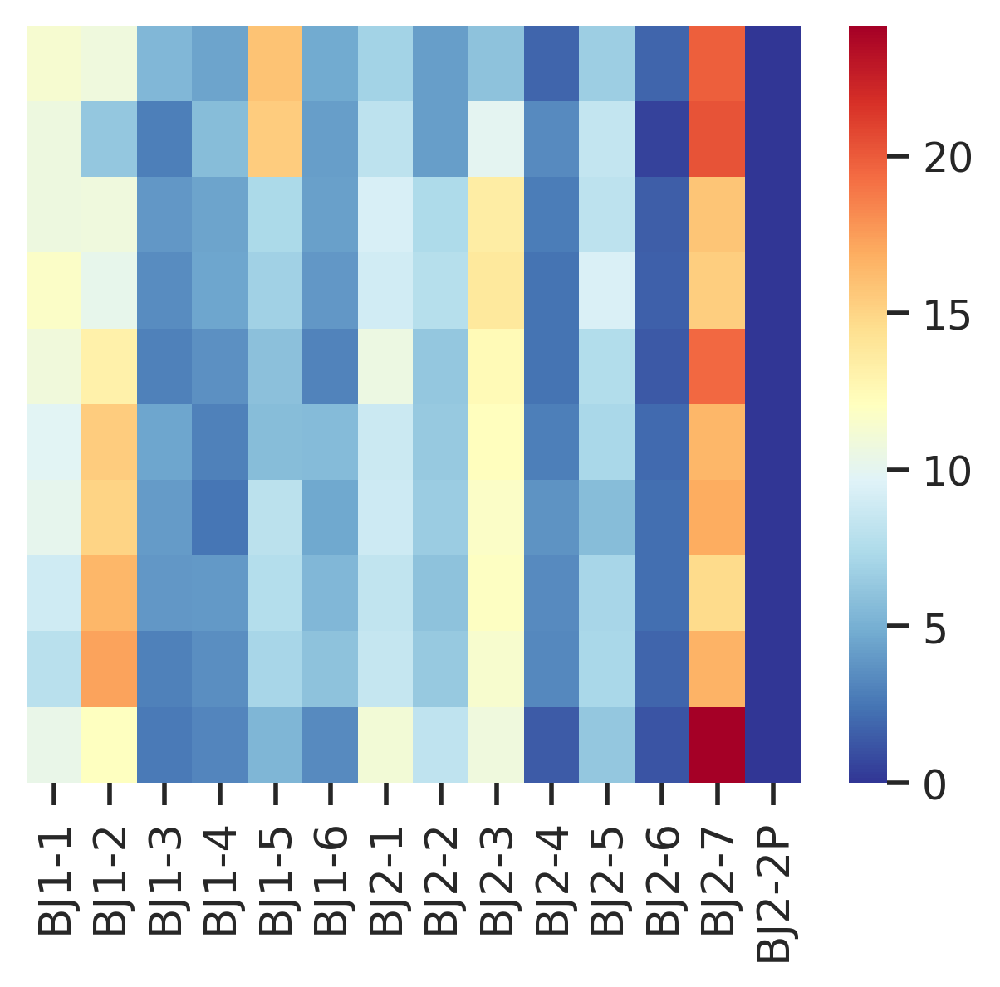

In [125]:
fig, ax = plt.subplots(figsize=(TCR_chain.shape[1]/3,TCR_chain.shape[0]*0.375))
#sb.set_theme()
uniform_data = TCR_chain
uniform_data=uniform_data.astype('float')
ax = sb.heatmap(uniform_data,cmap='RdYlBu_r')
_, xlabels = plt.xticks()
_, ylabels = plt.yticks()
ax.set_xticklabels(xlabels, size=12,rotation=90)
ax.set_yticklabels(ylabels, size=12,rotation=0)

ax.axes.get_yaxis().set_visible(False) # remove y axis tick and label
plt.savefig(fig_path+'TCR_TRBJ.pdf',bbox_inches='tight');

### use all TCR information for PCA plotting

In [87]:
bdata = adata_abtcr[adata_abtcr.obs['anno_lvl_2_final_clean'].isin(['DP(P)_T','DP(Q)_T','CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'])]

In [88]:
bdata = bdata[bdata.obs['ab_chain_pairing'].isin(['single pair','extra VJ','extra VDJ','two full chains'])]

In [89]:
#write csv for chi-square test
bdata.obs.to_csv('csv/TCR_VDJ_usage.csv') 

In [90]:
bdata.obs['smp_celltype'] = bdata.obs['Sample'].astype('string') +'_'+ bdata.obs['anno_lvl_2_final_clean'].astype('string')

Trying to set attribute `.obs` of view, copying.


In [91]:
df1 = pd.DataFrame({'smp_celltype': Counter(bdata.obs['smp_celltype']).keys(),
                  'cellcount': Counter(bdata.obs['smp_celltype']).values()})

In [92]:
new_list = df1.loc[df1['cellcount']>20,'smp_celltype'] # smp_celltype of at least 20 cells 

In [93]:
TCR_list = TRAV_list+TRAJ_list+TRBV_list+TRBJ_list

In [94]:
TCR = pd.DataFrame(columns = TCR_list, index = new_list)

In [95]:
for i in range(TCR.shape[0]):
    cell = TCR.index[i]
    counter1 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'ab_IR_VJ_1_v_gene'])
    for TRAV in TRAV_list:
        TCR.loc[cell,TRAV] = counter1[TRAV]
    
    counter2 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'ab_IR_VJ_1_j_gene'])
    for TRAJ in TRAJ_list:
        TCR.loc[cell,TRAJ] = counter2[TRAJ]
    
    counter3 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'ab_IR_VDJ_1_v_gene'])
    for TRBV in TRBV_list:
        TCR.loc[cell,TRBV] = counter3[TRBV]
        
    #counter4 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'ab_IR_VDJ_1_v_gene'])
    #for TRBD in TRBD_list:
        #TCR.loc[cell,TRBD] = counter3[TRBD]
        
    counter5 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'ab_IR_VDJ_1_j_gene'])
    for TRBJ in TRBJ_list:
        TCR.loc[cell,TRBJ] = counter5[TRBJ]
        
    #counter6 = Counter(bdata.obs.loc[bdata.obs['smp_celltype']==cell,'IR_VDJ_1_c_gene'])
    #for TRBC in TRBC_list:
        #TCR.loc[cell,TRBC] = counter6[TRBC]
        
    # normalise  
    TCR.loc[cell,TCR.columns.isin(TRAV_list)] = TCR.loc[cell,TCR.columns.isin(TRAV_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRAV_list)]) * 100 
    TCR.loc[cell,TCR.columns.isin(TRAJ_list)] = TCR.loc[cell,TCR.columns.isin(TRAJ_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRAJ_list)]) * 100
    TCR.loc[cell,TCR.columns.isin(TRBV_list)] = TCR.loc[cell,TCR.columns.isin(TRBV_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBV_list)]) * 100
    #TCR.loc[cell,TCR.columns.isin(TRBD_list)] = TCR.loc[cell,TCR.columns.isin(TRBD_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBD_list)]) * 100 
    TCR.loc[cell,TCR.columns.isin(TRBJ_list)] = TCR.loc[cell,TCR.columns.isin(TRBJ_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBJ_list)]) * 100
    #TCR.loc[cell,TCR.columns.isin(TRBC_list)] = TCR.loc[cell,TCR.columns.isin(TRBC_list)] / np.sum(TCR.loc[cell,TCR.columns.isin(TRBC_list)]) * 100

In [96]:
df2 = pd.DataFrame(index = TCR.index, columns=['cell_type'])
df2['cell_type'] = list(TCR.index)

In [97]:
TCR_adata = sc.AnnData(X =np.array(TCR), obs = df2, var = list(TCR.columns))

In [98]:
sc.pp.pca(TCR_adata, n_comps = 30, use_highly_variable = False, svd_solver = 'arpack', random_state = 1712)
#sc.pp.neighbors(TCR_adata)
#sc.tl.umap(TCR_adata, random_state = 1712)

In [99]:
TCR_adata.obs['cell_type']=TCR_adata.obs['cell_type'].astype('category')
TCR_adata.obs['cell_count']=lookup(TCR_adata.obs['cell_type'], df1,'smp_celltype','cellcount')
TCR_adata.obs['organ'] = lookup(TCR_adata.obs_names, bdata.obs, 'smp_celltype','organ')
TCR_adata.obs['age'] = lookup(TCR_adata.obs_names, bdata.obs, 'smp_celltype','age')
TCR_adata.obs['donor'] = lookup(TCR_adata.obs_names, bdata.obs, 'smp_celltype','donor')
TCR_adata.obs['cell_type'] = lookup(TCR_adata.obs['cell_type'], bdata.obs,'smp_celltype','anno_lvl_2_final_clean')

In [100]:
PCA = TCR_adata.obsm['X_pca'][:,range(2)]

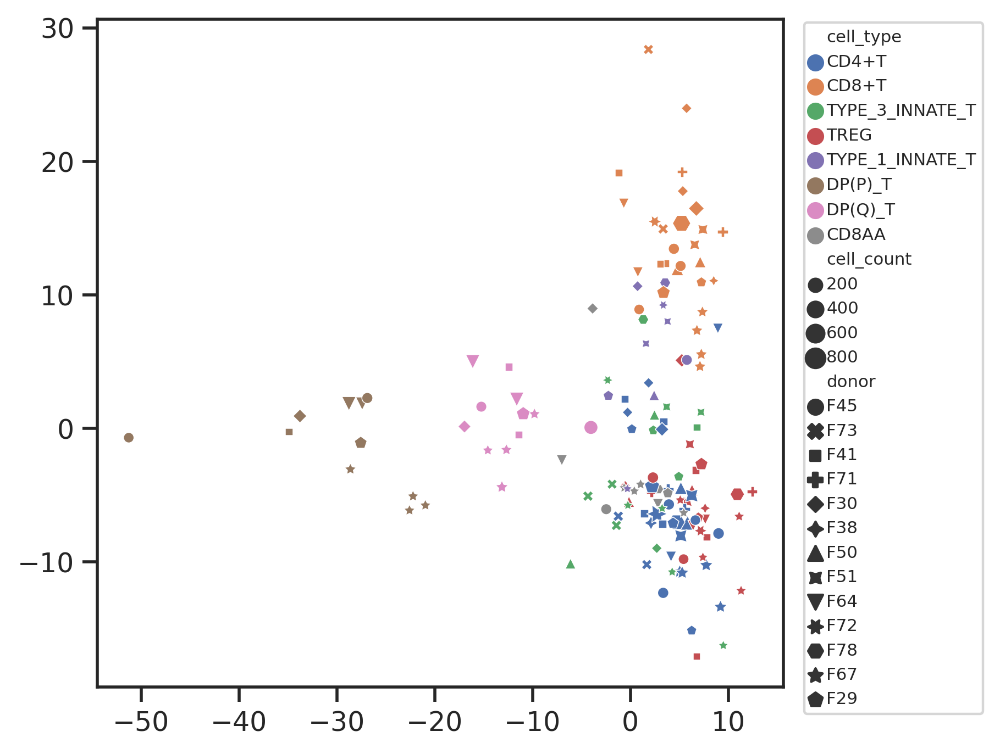

In [101]:
sb.set_theme(style='ticks')
fig, ax = plt.subplots(figsize=(5,5))
sb.scatterplot(x=-PCA[:,0],y=PCA[:,1], hue=TCR_adata.obs['cell_type'],size = TCR_adata.obs['cell_count'],style=TCR_adata.obs['donor'])
ax.legend(bbox_to_anchor=(1.03, 0.995), loc=2, borderaxespad=0.,fontsize='xx-small')
#plt.savefig('figures/TCR_PCA.pdf');

In [102]:
ct_list = ['DP(P)_T','DP(Q)_T','TYPE_1_INNATE_T','CD8AA','TYPE_3_INNATE_T','CD4+T','TREG', 'CD8+T']
df = pd.DataFrame({'PC1':-PCA[:,0],
                   'PC2':PCA[:,1],
                   'ct':TCR_adata.obs['cell_type'],
                   'cell_n': TCR_adata.obs['cell_count']
})
df['ct']=df['ct'].astype('category')
df['ct']=df['ct'].cat.reorder_categories(ct_list)

In [103]:
import sklearn 
pca = sklearn.decomposition.PCA(n_components =2)

def ct_centroid_dist(TCR):
    pc = pca.fit_transform(TCR)
    ct_centroid = pd.DataFrame(index=ct_list,
                               columns = ['PC1','PC2'])
    for ct in ct_list:
        tf = TCR_adata.obs['cell_type']==ct
        pc_ct = pc[tf,:]
        weights = np.ones(np.sum(tf))#np.array(TCR_adata.obs.loc[tf,'cell_count'])
        ct_centroid.loc[ct, :] = np.sum(pc_ct.T * weights, axis = 1) / np.sum(weights)
    ct_dist = pd.DataFrame(sp.spatial.distance.cdist(ct_centroid, ct_centroid), index = ct_list, columns = ct_list)
    return ct_dist, ct_centroid

In [104]:
ct_dist,ct_centroid=ct_centroid_dist(TCR)

In [105]:
ct_centroid.iloc[:,0]

DP(P)_T              29.536
DP(Q)_T               12.41
TYPE_1_INNATE_T    -2.07197
CD8AA             -0.236777
TYPE_3_INNATE_T    -1.88761
CD4+T              -4.07561
TREG               -6.46986
CD8+T              -4.82197
Name: PC1, dtype: object

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/seaborn/distributions.py:1657: FutureWarning: The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.5 for `bw_method`, but please see the docs for the new parameters and update your code.
  warnings.warn(msg, FutureWarning)


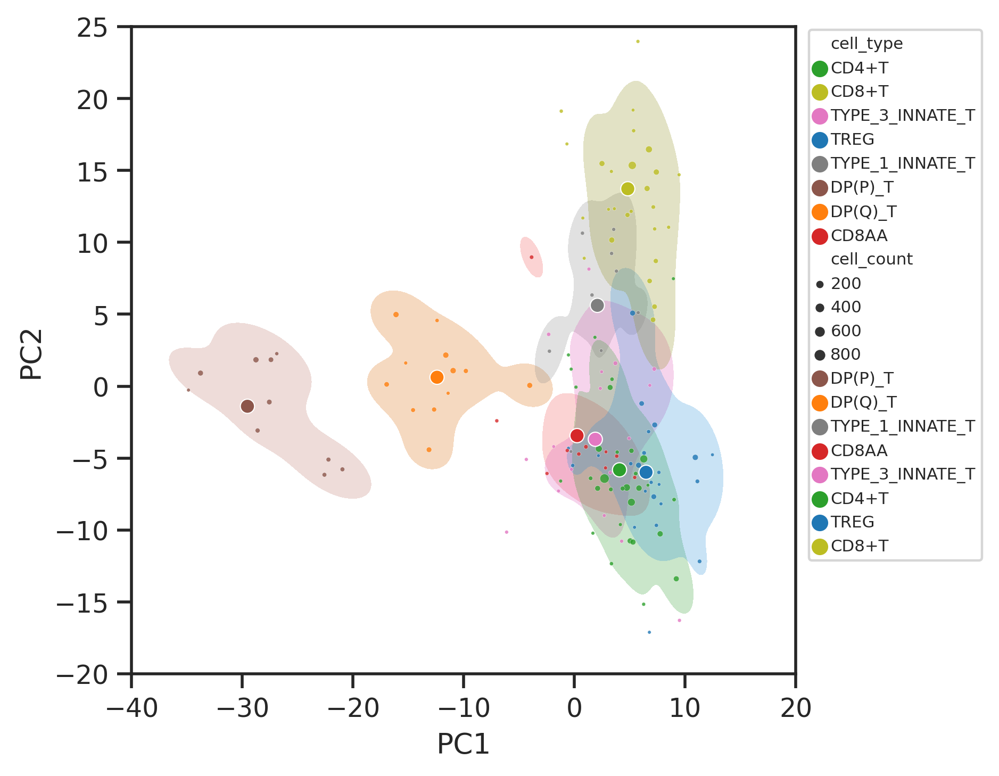

In [106]:
sb.set_theme(style='ticks')
color_order = np.array([5, 1, 7, 3, 6, 2, 0, 8])
ct_color_map = dict(zip(ct_list, np.array(sb.color_palette('tab10'))[color_order]))

fig, ax = plt.subplots(figsize=(5,5))
#plt.rcParams["figure.figsize"] = (5,5)
sb.kdeplot(data=df, x="PC1", y="PC2", hue="ct", fill=True,weights='cell_n',alpha=0.25,levels=[0.2,1],bw=0.5,palette=ct_color_map)
sb.scatterplot(x=-PCA[:,0],y=PCA[:,1], hue=TCR_adata.obs['cell_type'],
               palette=ct_color_map,size = TCR_adata.obs['cell_count'],sizes=(2,15),alpha=0.8)
sb.scatterplot(x=-ct_centroid.iloc[:,0],y=ct_centroid.iloc[:,1], hue=ct_centroid.index,palette=ct_color_map)

ax.set_ylim(-20,25)
ax.set_xlim(-40,20)
ax.legend(bbox_to_anchor=(1.02, 0.995), loc=2, borderaxespad=0.,fontsize='xx-small')
plt.savefig(fig_path+'TCR_PCA_centroid.pdf',bbox_inches='tight');

# gdTCR usage

In [126]:
# only leave samples that have gdTCR done, and no MAIT, CD137 sorting - adata_gdtcr
adata_gdtcr = adata[adata.obs['file'].isin(meta_gd['GEX file'])].copy() 
#adata_tcr = adata_tcr[adata_tcr.obs['file'].isin(meta_ab['GEX_id'])].copy()
adata_gdtcr = adata_gdtcr[~(adata_gdtcr.obs['Sort_id'].isin(['CD137','MAIT']))]

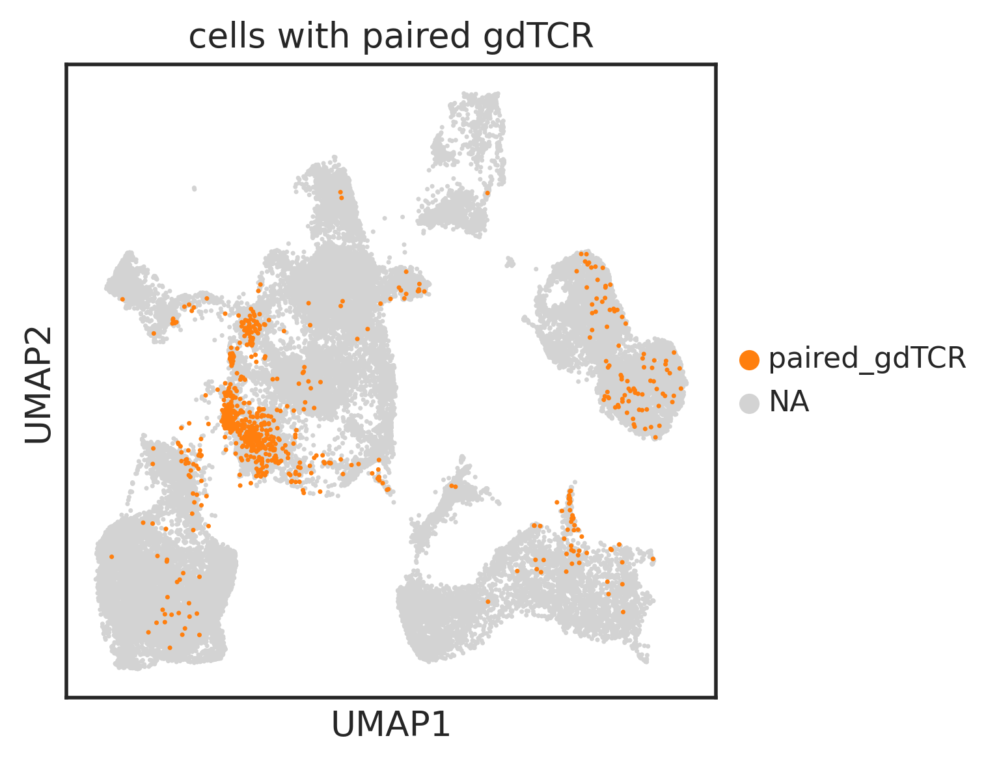

In [131]:
sc.pl.umap(adata_gdtcr, color=['gdTCR'], groups=['paired_gdTCR'],title='cells with paired gdTCR',
           legend_fontsize=10,size=10)

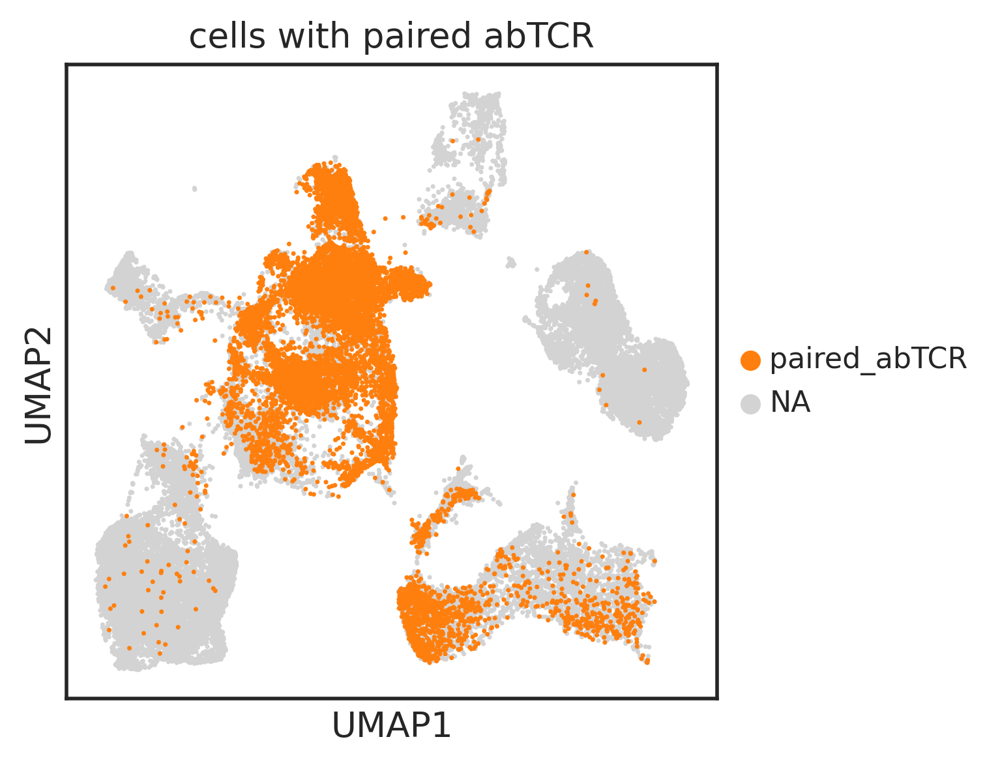

In [134]:
sc.pl.umap(adata_gdtcr, color=['abTCR'], groups=['paired_abTCR'],title='cells with paired abTCR',
           legend_fontsize=10,size=10)

In [127]:
# only leave T cells
a = adata_gdtcr.obs['anno_lvl_2_final_clean'].isin(['CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'])
gdT = adata_gdtcr[a].copy()

In [128]:
a = np.array(gdT.obsm['X_umap'][:,0]>-3) & np.array(gdT.obsm['X_umap'][:,0]<8) & np.array(gdT.obsm['X_umap'][:,1]>-2)
gdT_plot = gdT[a].copy()

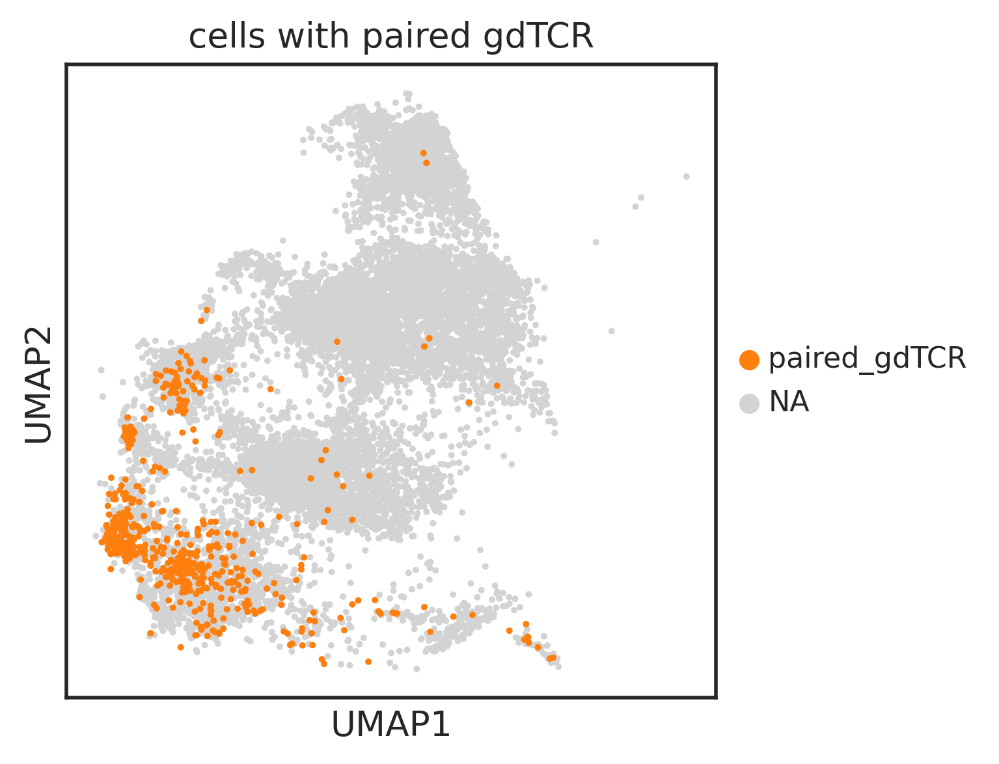

In [135]:
plt.rcParams["figure.figsize"] = [4,4]
sc.pl.umap(gdT_plot, color=['gdTCR'], groups=['paired_gdTCR'],title='cells with paired gdTCR',
           legend_fontsize=10,size=20,save='gdT.pdf')

In [136]:
# restrict data to samples that only have both abTCR and gdTCR sequenced - gdT_select
gdT_select = gdT[gdT.obs['file'].isin(meta_ab['GEX_id'])].copy()

In [137]:
a = list(gdT_select.obs['gdTCR']=='paired_gdTCR')
b = list(gdT_select.obs['abTCR']=='paired_abTCR')
c = list(~(gdT_select.obs['gdTCR']=='paired_gdTCR'))
d = list(~(gdT_select.obs['abTCR']=='paired_abTCR'))
dp = [x and y for x,y in zip(a,b)]
dn = [x and y for x,y in zip(c,d)]
gd = [x and y for x,y in zip(a,d)]
ab = [x and y for x,y in zip(b,c)]

In [138]:
gdT_select.obs.loc[dp,'TCR_combine']= 'both'
gdT_select.obs.loc[dn,'TCR_combine']= 'neither'
gdT_select.obs.loc[gd,'TCR_combine']= 'paired gdTCR'
gdT_select.obs.loc[ab,'TCR_combine']= 'paired abTCR'

... storing 'TCR_combine' as categorical


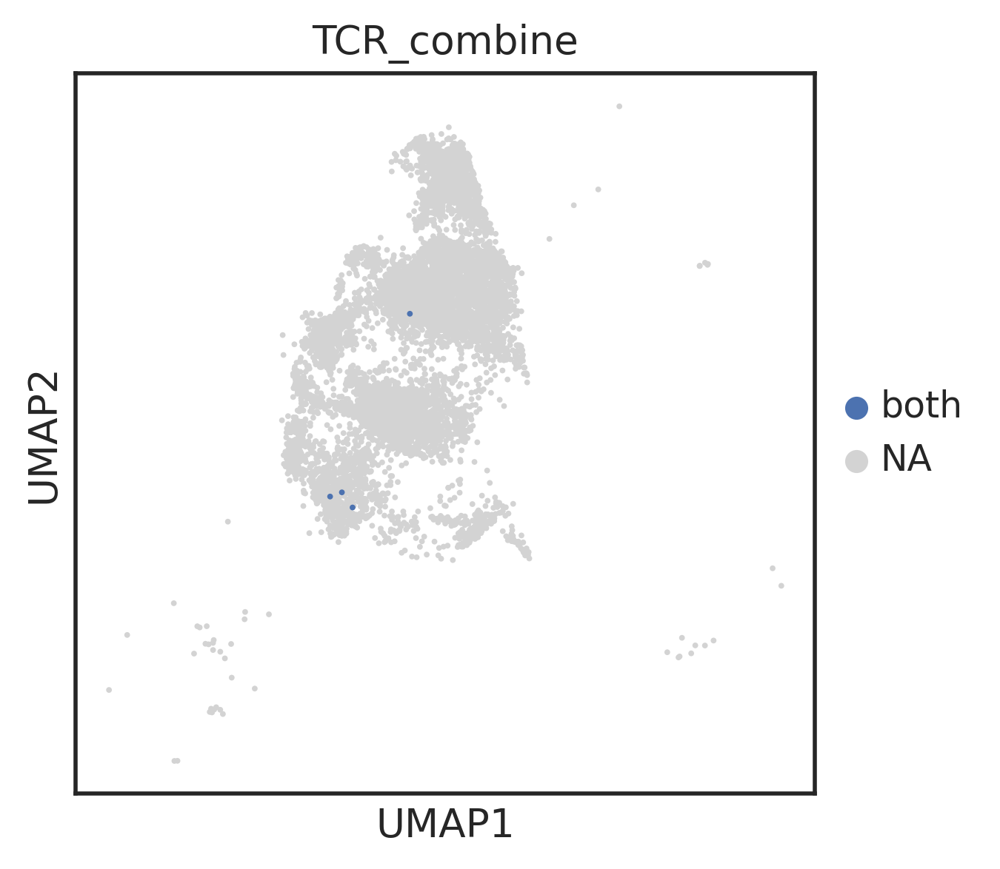

In [139]:
sc.pl.umap(gdT_select, color=['TCR_combine'],groups=['both'])

In [140]:
gdT_select.obs['TCR_combine'] = gdT_select.obs['TCR_combine'].cat.reorder_categories(['paired abTCR', 'paired gdTCR','both','neither'])

In [141]:
df = pd.DataFrame(index = ['CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'], columns = gdT_select.obs['TCR_combine'].cat.categories)
for ct in df.index:
    counter = Counter(gdT_select[gdT_select.obs['anno_lvl_2_final_clean']==ct].obs['TCR_combine'])
    for cat in df.columns:
        df.loc[ct, cat]=counter[cat]

In [142]:
sm = np.array(np.sum(df,axis=1)).reshape(df.shape[0],1)
df1=df / sm * 100
df1['ct']=df.index

In [143]:
df

,paired abTCR,paired gdTCR,both,neither
CD8+T,1613,17,0,328
CD4+T,3526,2,1,582
TREG,1366,2,0,200
CD8AA,203,38,0,116
TYPE_3_INNATE_T,575,79,0,137
TYPE_1_INNATE_T,391,222,3,397


In [144]:
df1

,paired abTCR,paired gdTCR,both,neither,ct
CD8+T,82.38,0.868233,0,16.7518,CD8+T
CD4+T,85.7699,0.04865,0.024325,14.1571,CD4+T
TREG,87.1173,0.127551,0,12.7551,TREG
CD8AA,56.8627,10.6443,0,32.493,CD8AA
TYPE_3_INNATE_T,72.6928,9.98736,0,17.3198,TYPE_3_INNATE_T
TYPE_1_INNATE_T,38.5982,21.9151,0.29615,39.1905,TYPE_1_INNATE_T


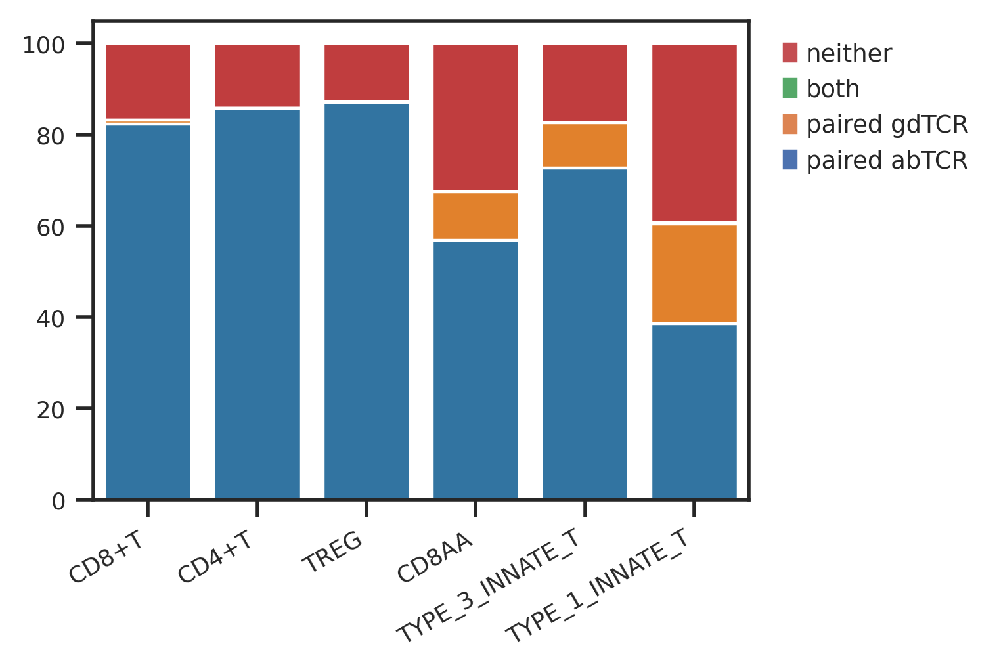

In [145]:
sb.set_theme(style='ticks')
fig, ax = plt.subplots(figsize=(4,3))
legend = []

for i in range(4)[::-1]:
    bar = sb.barplot(x='ct',  y=np.sum(df1.iloc[:,0:i+1],axis=1), data=df1, color=sb.color_palette('tab10')[i])
    legend = legend+[mpatches.Patch(color=sb.color_palette()[i], label=df1.columns[i])]
plt.xticks(fontsize=8,rotation=30,horizontalalignment='right')
plt.yticks(fontsize=8)
ax.set_xlabel('')
#ax.set_ylabel('Proportion of scVDJseq cells (%)')

# add legend
ax.legend(handles=legend,loc='upper left',bbox_to_anchor=(1.02, 1),frameon=False, fontsize='x-small')

plt.savefig(fig_path+'gdT.pdf',bbox_inches='tight');

### What's in neither category

In [146]:
no_tcr = gdT_select[gdT_select.obs['TCR_combine']=='neither']

In [147]:
Counter(no_tcr.obs['ab_chain_pairing'])

Counter({'orphan VDJ': 893, 'no IR': 732, 'orphan VJ': 135})

Trying to set attribute `.uns` of view, copying.


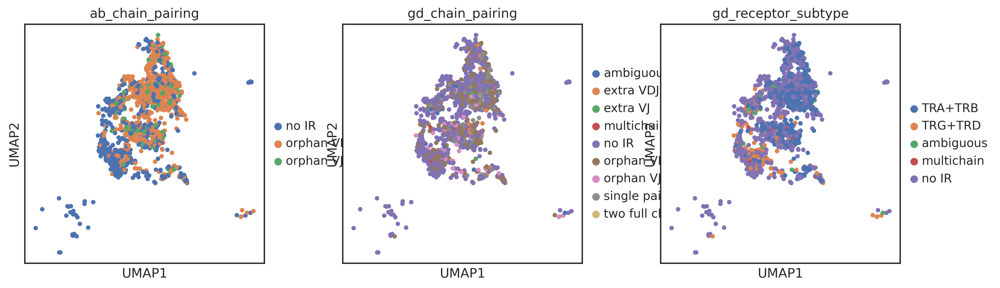

In [148]:
sc.pl.umap(no_tcr, color=['ab_chain_pairing','gd_chain_pairing','gd_receptor_subtype'])

In [149]:
Counter(no_tcr[no_tcr.obs['gd_receptor_subtype']=='TRG+TRD'].obs['gd_chain_pairing']) # so all TRG+TRD cells are either orphal VDJ or orphan VJ

Counter({'orphan VDJ': 152, 'orphan VJ': 56})

In [150]:
ab = no_tcr.obs['ab_chain_pairing'].isin(['orphan VDJ','orphan VJ'])
gd = no_tcr.obs['gd_receptor_subtype']=='TRG+TRD'
a = list(ab)
b = list(gd)
c = list(~ab)
d = list(~gd)
dp = [x and y for x,y in zip(a,b)]
dn = [x and y for x,y in zip(c,d)]
ab = [x and y for x,y in zip(a,d)]
gd = [x and y for x,y in zip(b,c)]

In [151]:
no_tcr.obs.loc[dp,'TCR_orphan_chain']= 'both'
no_tcr.obs.loc[dn,'TCR_orphan_chain']= 'neither'
no_tcr.obs.loc[gd,'TCR_orphan_chain']= 'orphan gdTCR'
no_tcr.obs.loc[ab,'TCR_orphan_chain']= 'orphan abTCR'

... storing 'TCR_orphan_chain' as categorical


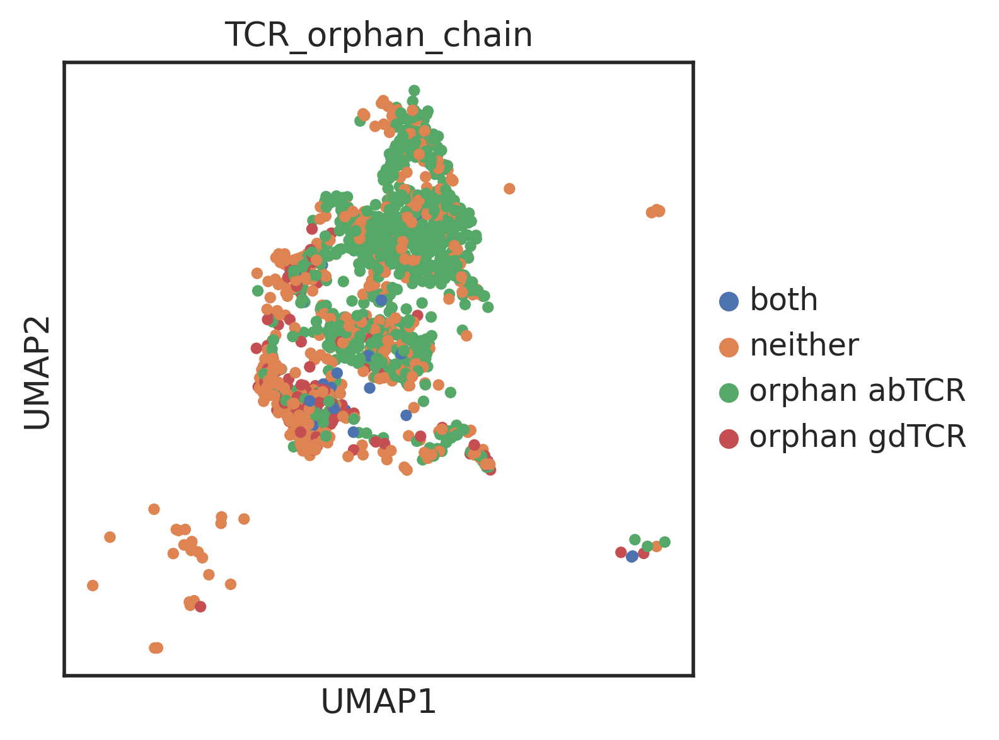

In [152]:
sc.pl.umap(no_tcr, color=['TCR_orphan_chain'])

In [153]:
no_tcr.obs['TCR_orphan_chain'] = no_tcr.obs['TCR_orphan_chain'].cat.reorder_categories(['orphan abTCR', 'orphan gdTCR','both','neither'])

In [154]:
df = pd.DataFrame(index = ['CD8+T','CD4+T','TREG','CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T'], columns = no_tcr.obs['TCR_orphan_chain'].cat.categories)
for ct in df.index:
    counter = Counter(no_tcr[no_tcr.obs['anno_lvl_2_final_clean']==ct].obs['TCR_orphan_chain'])
    for cat in df.columns:
        df.loc[ct, cat]=counter[cat]

In [155]:
sm = np.array(np.sum(df,axis=1)).reshape(df.shape[0],1)
df1=df / sm * 100
df1['ct']=df.index

In [156]:
df1

,orphan abTCR,orphan gdTCR,both,neither,ct
CD8+T,68.2927,3.35366,1.52439,26.8293,CD8+T
CD4+T,81.6151,0.687285,0.171821,17.5258,CD4+T
TREG,76,0,1,23,TREG
CD8AA,36.2069,14.6552,4.31034,44.8276,CD8AA
TYPE_3_INNATE_T,32.1168,21.8978,5.10949,40.8759,TYPE_3_INNATE_T
TYPE_1_INNATE_T,13.0982,26.9521,4.78589,55.1637,TYPE_1_INNATE_T


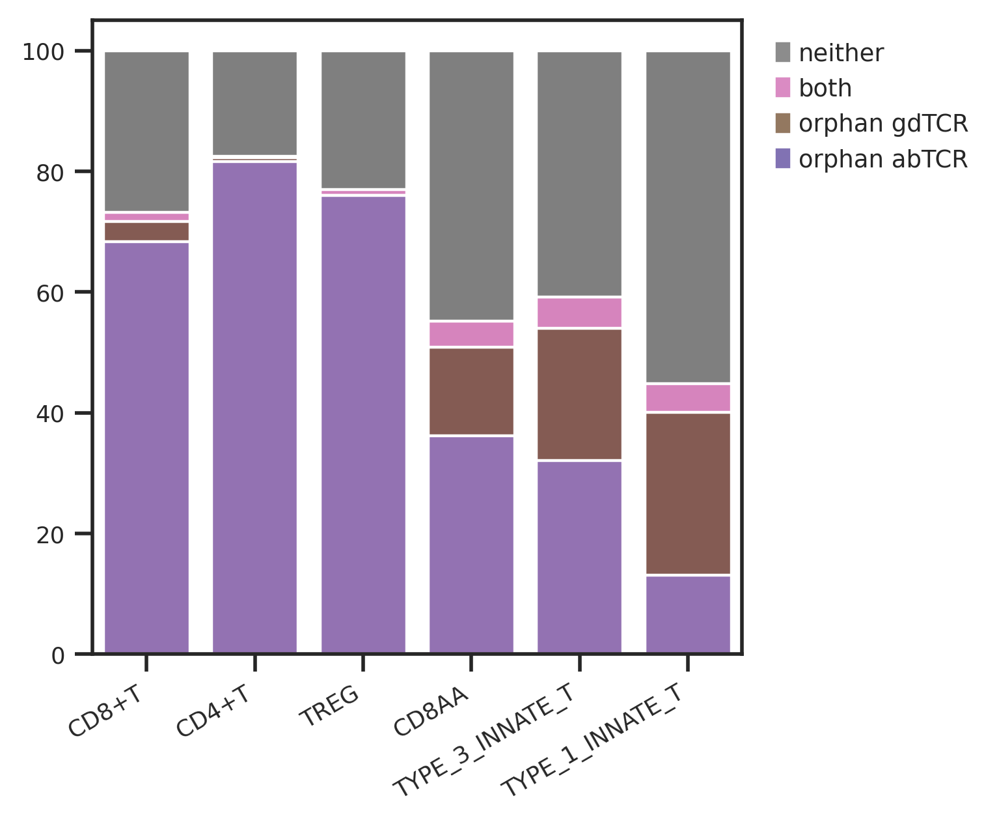

In [157]:
sb.set_theme(style='ticks')
fig, ax = plt.subplots(figsize=(4,4))
legend = []

for i in range(4)[::-1]:
    bar = sb.barplot(x='ct',  y=np.sum(df1.iloc[:,0:i+1],axis=1), data=df1, color=sb.color_palette('tab10')[i+4])
    legend = legend+[mpatches.Patch(color=sb.color_palette()[i+4], label=df1.columns[i])]
plt.xticks(fontsize=8,rotation=30,horizontalalignment='right')
plt.yticks(fontsize=8)
ax.set_xlabel('')

# add legend
ax.legend(handles=legend,loc='upper left',bbox_to_anchor=(1.02, 1),frameon=False, fontsize='x-small')

plt.savefig(fig_path+'TCR_no_chain.pdf',bbox_inches='tight');

### difference btw gdT and abT in CD8AA, TH17, NKT

In [158]:
# NKT
ct = ['TYPE_1_INNATE_T']
a = list(gdT_select.obs['anno_lvl_2_final_clean'].isin(ct))
b = list(gdT_select.obs['TCR_combine'].isin(['paired abTCR','paired gdTCR']))
mask = [a and b for a,b in zip(a,b)]
gdT_select_ct = gdT_select[mask]
sc.tl.rank_genes_groups(gdT_select_ct, 'TCR_combine', method = 'wilcoxon', use_raw = True)
result = gdT_select_ct.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_clusters = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})
wilcox_clusters.head(10)

Trying to set attribute `.uns` of view, copying.


,paired abTCR_n,paired abTCR_l,paired abTCR_p,paired gdTCR_n,paired gdTCR_l,paired gdTCR_p
0,CD8A,2.989519,1.114780e-25,TRDV2,11.062264,1.378004e-69
1,CD8B,3.969378,1.324605e-15,TRDC,6.771310,7.600808e-44
2,CD2,2.227485,3.690866e-10,TRGV9,3.204085,1.256857e-19
3,NUCB2,2.000985,8.960292e-07,RPLP1,0.304875,3.069170e-07
4,ISG20,1.666939,1.085732e-06,RPLP0,0.371121,6.387782e-07
5,TRAC,1.331822,2.812804e-03,CD247,0.970775,1.256893e-04
6,HSPB1,1.269196,3.811099e-03,KLRB1,1.524137,2.145621e-03
7,KLRD1,1.605341,8.902364e-03,EEF1A1,0.152940,3.019491e-03
8,TCF7,1.107498,2.402791e-02,ZBTB16,1.376732,1.092288e-02
9,JUNB,0.878996,3.286511e-02,CCL4,1.673047,1.092288e-02


In [159]:
print(sum(wilcox_clusters['paired abTCR_p'] < 0.05)) # only 9 significant results 
NKT_sig = list(wilcox_clusters.loc[wilcox_clusters['paired abTCR_p'] < 0.05, 'paired abTCR_n'])

33


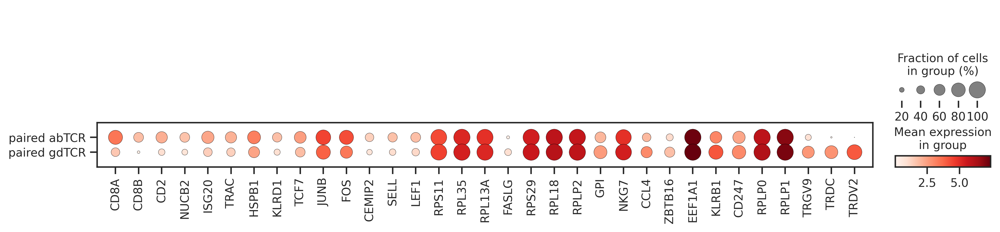

In [160]:
sc.pl.dotplot(gdT_select_ct, var_names=NKT_sig,groupby='TCR_combine',save = 'TYPE_1_INNATE_T_gd_ab_comparison.pdf')

In [161]:
ct = ['TYPE_3_INNATE_T']
a = list(gdT_select.obs['anno_lvl_2_final_clean'].isin(ct))
b = list(gdT_select.obs['TCR_combine'].isin(['paired abTCR','paired gdTCR']))
mask = [a and b for a,b in zip(a,b)]
gdT_select_ct = gdT_select[mask]
sc.tl.rank_genes_groups(gdT_select_ct, 'TCR_combine', method = 'wilcoxon', use_raw = True)
result = gdT_select_ct.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_clusters = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})
wilcox_clusters.head(10)

Trying to set attribute `.uns` of view, copying.


,paired abTCR_n,paired abTCR_l,paired abTCR_p,paired gdTCR_n,paired gdTCR_l,paired gdTCR_p
0,TRAC,1.567677,0.002945,TRDV2,10.390391,1.907963e-38
1,FYB1,1.640686,0.003842,TRDC,8.055444,4.327714e-25
2,CORO1B,1.713143,0.018619,CD247,2.310640,7.514449e-13
3,TRAT1,1.548863,0.019528,TRGV9,4.351175,7.923608e-13
4,ANXA1,0.966889,0.054707,NKG7,2.375619,4.383508e-04
5,CYTIP,0.942919,0.096814,PPIA,0.460442,4.912047e-04
6,GPR183,1.751778,0.164634,NPM1,0.406206,1.715888e-02
7,ITM2A,1.212372,0.164634,RPLP0,0.250781,1.861882e-02
8,TPT1,0.214870,0.190376,LSP1,0.733810,1.593182e-01
9,CD6,1.543901,0.206244,STMN1,1.399862,2.599463e-01


In [162]:
print(sum(wilcox_clusters['paired abTCR_p'] < 0.05)) # only 9 significant results 
TH17_sig = list(wilcox_clusters.loc[wilcox_clusters['paired abTCR_p'] < 0.05, 'paired abTCR_n'])

12


In [163]:
[gene for gene in TH17_sig if gene in NKT_sig]

['TRAC', 'RPLP0', 'NKG7', 'TRGV9', 'CD247', 'TRDC', 'TRDV2']

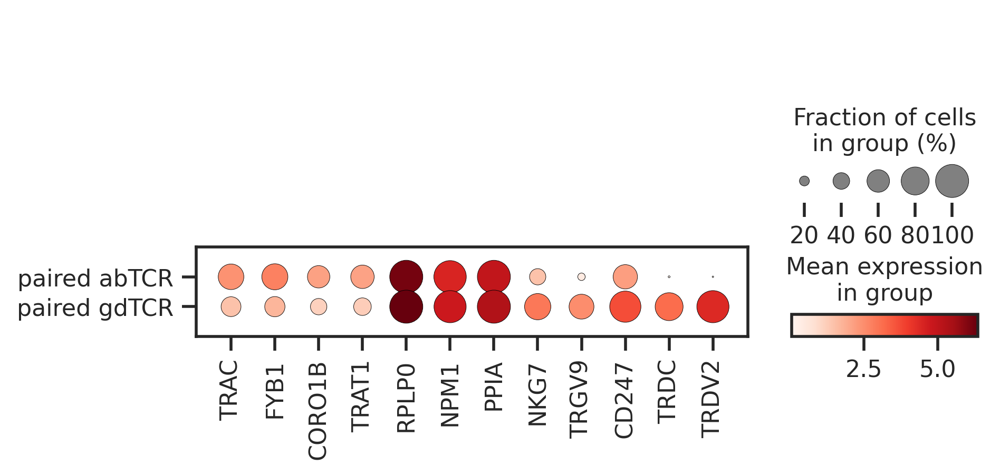

In [164]:
sc.pl.dotplot(gdT_select_ct, var_names=TH17_sig,groupby='TCR_combine',save = 'TYPE_3_INNATE_T_gd_ab_comparison.pdf')

In [165]:
ct = ['CD8AA']
a = list(gdT_select.obs['anno_lvl_2_final_clean'].isin(ct))
b = list(gdT_select.obs['TCR_combine'].isin(['paired abTCR','paired gdTCR']))
mask = [a and b for a,b in zip(a,b)]
gdT_select_ct = gdT_select[mask]
sc.tl.rank_genes_groups(gdT_select_ct, 'TCR_combine', method = 'wilcoxon', use_raw = True)
result = gdT_select_ct.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_clusters = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})
wilcox_clusters.head(10)

Trying to set attribute `.uns` of view, copying.


,paired abTCR_n,paired abTCR_l,paired abTCR_p,paired gdTCR_n,paired gdTCR_l,paired gdTCR_p
0,CD8A,5.595959,6.350288e-10,TRDV2,9.548094,5.349395e-10
1,NUCB2,3.019346,5.777407e-06,TRDC,5.750309,7.292881e-10
2,ITM2C,1.675966,1.236258e-02,LSP1,2.803378,6.164493e-04
3,TRAC,1.694517,1.236258e-02,CD247,2.178666,1.573632e-03
4,CAMK4,1.986777,2.642103e-02,HINT1,1.220488,1.595641e-03
5,TIAM1,2.363782,5.854555e-02,RPS23,0.571910,2.536123e-03
6,CD2,1.778861,7.098389e-02,RPS15,0.583366,1.813835e-02
7,SOD1,1.663645,7.247166e-02,TPT1,0.552507,5.227508e-02
8,PRKCH,1.641778,8.558958e-02,ZYX,1.928385,5.854555e-02
9,AQP3,2.292653,9.304616e-02,RPL39,0.574388,5.854555e-02


In [166]:
print(sum(wilcox_clusters['paired abTCR_p'] < 0.05)) # only 9 significant results 
CD8AA_sig = list(wilcox_clusters.loc[wilcox_clusters['paired abTCR_p'] < 0.05, 'paired abTCR_n'])

12


In [167]:
[gene for gene in CD8AA_sig if gene in NKT_sig]

['CD8A', 'NUCB2', 'TRAC', 'CD247', 'TRDC', 'TRDV2']

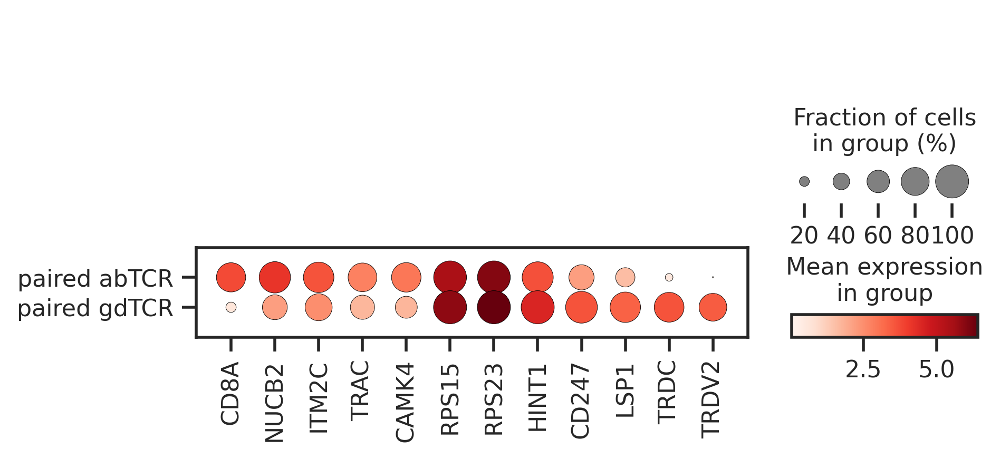

In [168]:
sc.pl.dotplot(gdT_select_ct, var_names=CD8AA_sig,groupby='TCR_combine',save = 'CD8AA_gd_ab_comparison.pdf')

# gd VDJ usage

In [169]:
adata_select = adata_gdtcr[adata_gdtcr.obs['gdTCR']=='paired_gdTCR']

In [170]:
#write csv for chi-square test
adata_select.obs.to_csv('csv/gdTCR_VDJ_usage.csv') 

In [171]:
# check all genes from adata are inside
TRGV_list = list(adata_select.obs['gd_IR_VJ_1_v_gene'].cat.categories)
TRGJ_list = list(adata_select.obs['gd_IR_VJ_1_j_gene'].cat.categories)
#TRGC_list = list(adata_select.obs['gd_IR_VJ_1_c_gene'].cat.categories[:-1])
TRDV_list = list(adata_select.obs['gd_IR_VDJ_1_v_gene'].cat.categories)
TRDD_list = list(adata_select.obs['gd_IR_VDJ_1_d_gene'].cat.categories[:-1])
TRDJ_list = list(adata_select.obs['gd_IR_VDJ_1_j_gene'].cat.categories[1:])
TCR_list = TRGV_list+TRGJ_list+TRDV_list+TRDD_list+TRDJ_list

In [172]:
TCR_list

['TRGV2*01',
 'TRGV2*02',
 'TRGV2*03',
 'TRGV3*01',
 'TRGV4*01',
 'TRGV4*02',
 'TRGV5*01',
 'TRGV8*01',
 'TRGV9*01',
 'TRGV9*01,TRGV9*02',
 'TRGV10*01',
 'TRGV10*01,TRGV10*02',
 'TRGV10*02',
 'TRGJ1*01',
 'TRGJ1*02,TRGJ2*01',
 'TRGJP1*01',
 'TRGJP2*01',
 'TRGJP*01',
 'TRAV29/DV5*01',
 'TRAV29/DV5*04',
 'TRAV38-2/DV8*01',
 'TRDV1*01',
 'TRDV2*01',
 'TRDV2*01,TRDV2*02',
 'TRDV2*03',
 'TRDV3*01',
 'TRDV3*01,TRDV3*02',
 'TRDV3*02',
 'TRDD3*01',
 'TRDJ2*01',
 'TRDJ3*01',
 'TRDJ4*01']

### heatmap plotting

In [173]:
ct_select =['CD8AA','TYPE_3_INNATE_T','TYPE_1_INNATE_T']
TCR_chain = None

Dict = {'gd_IR_VJ_1_v_gene':TRGV_list,
        'gd_IR_VJ_1_j_gene': TRGJ_list,
        'gd_IR_VDJ_1_v_gene': TRDV_list,
       'gd_IR_VDJ_1_d_gene':TRDD_list,
       'gd_IR_VDJ_1_j_gene':TRDJ_list}

for name in list(Dict.keys()):
    df = pd.DataFrame(columns = Dict[name],  index = ct_select)
    
    for cell in df.index:
        counter = Counter(adata_select.obs.loc[adata_select.obs['anno_lvl_2_final_clean']==cell,name])
        for chain_type in df.columns:
            df.loc[cell, chain_type]=counter[chain_type]
        
        df.loc[cell,:] = df.loc[cell,:] / np.sum(df.loc[cell,:]) * 100
    
    if TCR_chain is None:
        TCR_chain = df.copy()
    else:
        TCR_chain = pd.concat([TCR_chain, df], axis=1)

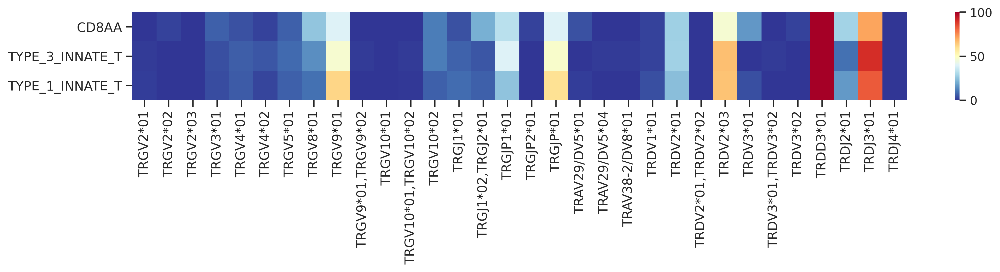

In [174]:
fig, ax = plt.subplots(figsize=(TCR_chain.shape[1]/2,TCR_chain.shape[0]/2))
#sb.set_theme()
uniform_data = TCR_chain
uniform_data=uniform_data.astype('float')
ax = sb.heatmap(uniform_data,cmap='RdYlBu_r', yticklabels=True)
_, xlabels = plt.xticks()
_, ylabels = plt.yticks()
ax.set_xticklabels(xlabels, size=12,rotation=90)
ax.set_yticklabels(ylabels, size=12,rotation=0)
plt.savefig(fig_path+'gdTCR_heatmap.pdf',bbox_inches='tight');

### chi-square test to look for differential usage across 3 cts

In [252]:
TCR = pd.read_csv('csv/gdTCR_VDJ_usage.csv', index_col=0)

In [253]:
TCR = TCR.loc[TCR['anno_lvl_2_final_clean'].isin(ct_select),
              ['anno_lvl_2_final_clean','gd_IR_VDJ_1_v_gene', 'gd_IR_VDJ_1_j_gene', 'gd_IR_VJ_1_v_gene', 'gd_IR_VDJ_1_d_gene','gd_IR_VJ_1_j_gene']]

In [254]:
df = pd.DataFrame(columns=['pval','adj_pval'])

In [255]:
TCR_gene = ['gd_IR_VDJ_1_v_gene', 'gd_IR_VDJ_1_j_gene', 'gd_IR_VJ_1_v_gene', 'gd_IR_VJ_1_j_gene']
tot = Counter(TCR['anno_lvl_2_final_clean'])

for gene in TCR_gene:
    for chain in set(TCR[gene]):
        counter = Counter(TCR.loc[TCR[gene]==chain,'anno_lvl_2_final_clean'])
        observed = pd.DataFrame(index = ct_select,columns =['observed','rest'])
        for ct in ct_select:
            observed.loc[ct, 'observed']=counter[ct]
            observed.loc[ct, 'rest'] = tot[ct] - counter[ct]
        
        _,df.loc[chain,'pval'],_, _ = sp.stats.chi2_contingency(observed=observed)

In [256]:
# for adjusted pval calculation
from rpy2.robjects.packages import importr
from rpy2.robjects.vectors import FloatVector
stats = importr('stats') 

In [257]:
df.loc[:,'adj_pval']=stats.p_adjust(FloatVector(df.loc[:,'pval']), method = 'BH')

In [258]:
df.loc[df['adj_pval']< 0.05,:]

,pval,adj_pval
TRDV3*01,8.43867e-05,0.002616
TRGV8*01,0.0057995,0.044946
TRGV9*01,0.00140796,0.021823
"TRGJ1*02,TRGJ2*01",0.0022666,0.023422


In [260]:
df

,pval,adj_pval
TRAV29/DV5*04,0.0975675,0.189037
"TRDV3*01,TRDV3*02",0.0975675,0.189037
TRAV38-2/DV8*01,0.0975675,0.189037
TRDV3*01,8.43867e-05,0.002616
TRDV1*01,0.538182,0.834182
TRDV2*01,0.645554,0.870094
"TRDV2*01,TRDV2*02",0.841327,0.881678
TRDV3*02,0.0823643,0.189037
TRDV2*03,0.0380122,0.168340
TRAV29/DV5*01,0.0792056,0.189037
